In [1]:
from music_decomposer import train_test_CNN

import pandas as pd

%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd
import crepe
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

import glob

Using TensorFlow backend.
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/opt/anaconda3/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py

# Import prepared files

In [2]:
song = 'eyeofthetiger'

eye_songpath = glob.glob("/Users/Sosa/Repos/project-final/your-project/Data/" + song + "/*.mp3")

eye_songpath

full_song = train_test_CNN()

['/Users/Sosa/Repos/project-final/your-project/Data/eyeofthetiger/Guitar.mp3',
 '/Users/Sosa/Repos/project-final/your-project/Data/eyeofthetiger/Rhythm.mp3',
 '/Users/Sosa/Repos/project-final/your-project/Data/eyeofthetiger/Drums.mp3',
 '/Users/Sosa/Repos/project-final/your-project/Data/eyeofthetiger/mix.mp3',
 '/Users/Sosa/Repos/project-final/your-project/Data/eyeofthetiger/Song.mp3']

In [3]:
start, end = (60, 65)

window = 10
stride = 1

train, test, original = train_test_CNN(eye_songpath[-2], 
                             eye_songpath[2],
                             start= start,
                             end= end,
                             window = window,
                             stride = stride)

In [28]:
start, end = (0, 420)

full, test, original = train_test_CNN(eye_songpath[-2], 
                             eye_songpath[2],
                             start= start,
                             end= end,
                             window = window,
                             stride = stride)

# CNN

In [4]:
from keras.models import Sequential
from keras.layers import Dense, Conv1D, Flatten, Dropout, MaxPooling1D

In [5]:
# input_neurons = 128, 
# strides = 2, 
# kernel_size=3, 
# input_activation='relu' 
    
# hidden_neurons = 64, 
# hidden_kernel_size=3, 
# hidden_activation='relu' 
                     
    
# pool_size=1, 
# pool_strides=2, 
# padding='valid', 
# data_format='channels_last'
    
# dropout = 0.5
        
# Dense_1 = 100, 
# Dense_1_activation='relu'
    
# output_activation='tanh'
    
# optimizer='adam',
# loss='mean_squared_error'
# metrics='accuracy'

In [6]:
def create_model():
    
    model = Sequential()
    
    model.add(Conv1D(128, 
#                      strides=2, 
                     kernel_size=3, activation='relu', 
                     input_shape=(window, 1), 
                     name='input_layer'))
    
    model.add(Conv1D(64, 
                     kernel_size=3, 
                     activation='relu', 
                     name='conv32_layer'))
    
    model.add(MaxPooling1D(pool_size=1, 
                           strides=2, 
                           padding='valid', 
                           data_format='channels_last'))
    
    model.add(Dropout(0.5))
    
    model.add(Flatten())
    
    model.add(Dense(100, 
                    activation='relu'))
    
    model.add(Dense(1, 
                    activation='tanh')) 
    
    model.compile(loss='mse', 
                  optimizer='adam', 
                  metrics=['mse', 'mae', 'mape', 'cosine'])
    
    return model

model1D = create_model()

Instructions for updating:
Colocations handled automatically by placer.


In [7]:
model1D.summary()


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_layer (Conv1D)         (None, 8, 128)            512       
_________________________________________________________________
conv32_layer (Conv1D)        (None, 6, 64)             24640     
_________________________________________________________________
max_pooling1d_1 (MaxPooling1 (None, 3, 64)             0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 3, 64)             0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 192)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 100)               19300     
_________________________________________________________________
dense_2 (Dense)              (None, 1)                

In [18]:
history = model1D.fit(train, test, epochs=20, batch_size=50, verbose=1)


Epoch 1/20
110241/110241 [==============================] - 5s 48us/step - loss: 0.0075 - mse: 0.0075 - mae: 0.0438 - mape: 710.2883 - cosine: 0.0899
Epoch 2/20
110241/110241 [==============================] - 5s 47us/step - loss: 0.0075 - mse: 0.0075 - mae: 0.0437 - mape: 565.2484 - cosine: 0.0863
Epoch 3/20
110241/110241 [==============================] - 5s 50us/step - loss: 0.0075 - mse: 0.0075 - mae: 0.0437 - mape: 663.5400 - cosine: 0.0908
Epoch 4/20
110241/110241 [==============================] - 6s 52us/step - loss: 0.0075 - mse: 0.0075 - mae: 0.0437 - mape: 717.5586 - cosine: 0.0921
Epoch 5/20
110241/110241 [==============================] - 6s 55us/step - loss: 0.0074 - mse: 0.0074 - mae: 0.0436 - mape: 619.4872 - cosine: 0.0895: 1s - loss: 0.0074 - mse: 0.0074 - mae: 0.0437 - mape: 
Epoch 6/20
110241/110241 [==============================] - 6s 56us/step - loss: 0.0075 - mse: 0.0075 - mae: 0.0437 - mape: 751.6740 - cosine: 0.0931
Epoch 7/20
110241/110241 [==================

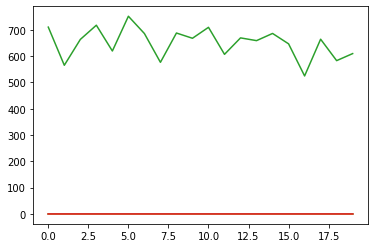

In [19]:
# plot metrics
plt.plot(history.history['mse'])
plt.plot(history.history['mae'])
plt.plot(history.history['mape'])
plt.plot(history.history['cosine'])
plt.show()

In [ ]:
history.history

In [ ]:
model1D.fit(train, test, batch_size=1, epochs=1)

In [32]:
result = model1D.predict(train)

In [33]:
predicted = result.T

# Evaluation

hear

In [34]:
sr = 22050

In [35]:
ipd.Audio(original, rate=sr)

In [36]:
ipd.Audio(test, rate=sr)

In [37]:
ipd.Audio(predicted, rate=sr)

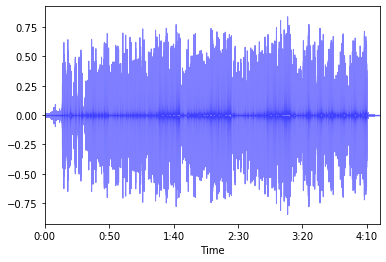

In [38]:
#sine wave

librosa.display.waveplot(predicted, sr=sr, color='blue', alpha=0.5)

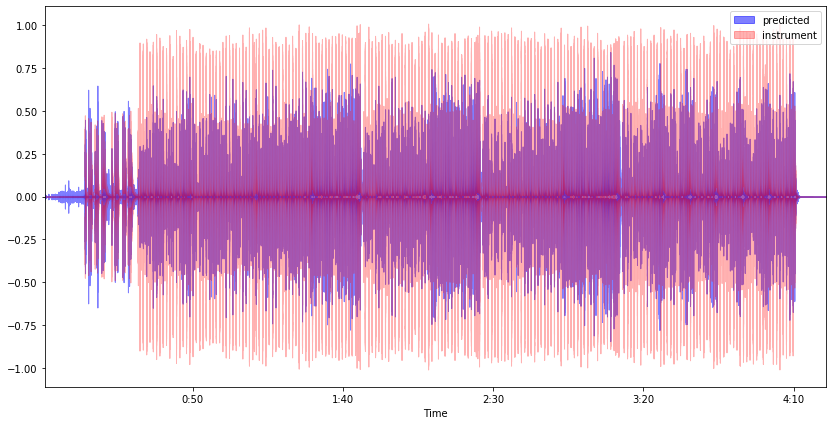

In [39]:
#sine wave detail comparison

fig = plt.figure(figsize=(14, 7))

librosa.display.waveplot(predicted, sr=sr, color='blue', alpha=0.5, offset=0.7, max_points= 0.5)
librosa.display.waveplot(test, sr=sr, color='red', alpha=0.3, offset=0.7, max_points= 0.5 )

plt.legend(['predicted', 'instrument'])

# plt.savefig('imgs/drum_test_1.png')

In [ ]:
# espectrogram

# Grid Search

In [ ]:
# from sklearn.model_selection import GridSearchCV

In [ ]:
# input_neurons = [32, 64, 128]
# strides = [1, 2, 4] 
# kernel_size = 3 
# input_activation= ['relu', 'tanh']

# hidden_neurons = [16, 32, 64]
# hidden_kernel_size= 3 
# hidden_activation= ['relu', 'tanh']

# pool_size= [1, 2, 3, 9] 
# pool_strides=2
# padding='valid' 
# data_format= 'channels_last'

# dropout = 0.5

# Dense_1 = 100, 
# Dense_1_activation='relu'
    
# output_activation='tanh'
    
# optimizer='adam',
# loss='mean_squared_error'
# metrics='accuracy'


# batch_size = [1, 2, 3, 9]
# epochs = [1, 5, 10]

# param_grid = dict(input_neurons = input_neurons,
#                   strides = strides,
#                   kernel_size= kernel_size,
#                   batch_size= batch_size,
#                   input_activation= input_activation,
#                   hidden_neurons = hidden_neurons,
#                   hidden_kernel_size = hidden_kernel_size,
#                   hidden_activation= hidden_activation,
#                   pool_size= pool_size, 
#                   pool_strides= pool_strides,
#                   padding= padding, 
#                   data_format= data_format,
#                   dropout = dropout,
#                   Dense_1 = Dense_1, 
#                   Dense_1_activation= Dense_1_activation,
#                   output_activation= output_activation
#                   optimizer= optimizer,
#                   loss= loss, 
#                   metrics= metrics,
#                   batch_size = batch_size
#                   epochs=epochs)

# grid = GridSearchCV(estimator=model1d, param_grid=param_grid, n_jobs=-1, cv=3)

# grid_result = grid.fit(train, test)

In [ ]:
# print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# means = grid_result.cv_results_['mean_test_score']
# stds = grid_result.cv_results_['std_test_score']
# params = grid_result.cv_results_['params']
# for mean, stdev, param in zip(means, stds, params):
#     print("%f (%f) with: %r" % (mean, stdev, param))

# Notes

For the model, we've been testing with samples of 30 seconds on the drums.

Structure:

    - Input layer 1D Conv
    - Hidden layer 1D Conv
    - MaxPooling1D
    - Dropout
    - Flatten
    - Dense
    - Output layer 1D
    
Optimizer:

    - Adam
    
Metrics:

    - Loss:
        - mean_squared_error
        
    - metrics:
        - MSE
        
Fit:

    - batch_size=3
    
    - epochs=1
    
    
Hyperparameter Tuning:


    - model = Sequential()

    - model.add(Conv1D(128
                 strides=2, 
                 kernel_size=3, 
                 activation='relu', 
                 input_shape=(window, 1), 
                 name='input_layer'))
                 
    - model.add(Conv1D(64, 
                    kernel_size=3, 
                    activation='relu', 
                    name='conv32_layer'))
                    
    - model.add(MaxPooling1D(pool_size=1, 
                            strides=2, 
                            padding='valid', 
                            data_format='channels_last'))
                            
    - model.add(Dropout(0.5))
    - model.add(Flatten())
    - model.add(Dense(100, activation='relu'))
    - model.add(Dense(1, activation='tanh')) 
    
model.compile(
            optimizer='adam',
            loss='mean_squared_error',
            metrics=['MSE'],
            )


In [ ]:
test_notes = pd.DataFrame(columns=['nº test', 'note', 'instrument', 'duration_s', 'error', 'accuracy'])


In [ ]:
new_row = {'nº Test':1            , 
           'notes': '',
           'instrument': 'Drums'      , 
           'duration_s': 30      ,
           'error':  error             ,
           'accuracy': acc           ,
          }

# test_notes = test_notes.append(new_row, ignore_index=True)

In [ ]:
test_notes